# post processing of ripples

This notebook reads in ripple results created in detect_swr_with_ripple_detection.py, creates a nice data frame containing ripple features, and then syncs those ripple times to the manually curated ripples from neuroscope event files. 

Manual curatation allows the removal of false-positive ripples caused by chewing and head-bumps. While detect_swr_with_ripple_detection.py has an intracrianal emg filter and a filter to remove ripples with one large peak data point, a lot of noise still gets by which can be removed via manual curatation.

In [1]:
# data managment and math functions
import pandas as pd
import numpy as np
import math

# plotting
from matplotlib import pyplot as plt

import neuroseries as nts

from scipy import stats

# for loading files
import h5py
import sys,os
import glob
import pickle

# Continuous Wavelet Transform
import obspy
from obspy.imaging.cm import obspy_sequential
from obspy.signal.tf_misfit import cwt


Bad key "text.kerning_factor" on line 4 in
D:\ryanh\Anaconda3\envs\ripple_analysis\lib\site-packages\matplotlib\mpl-data\stylelib\_classic_test_patch.mplstyle.
You probably need to get an updated matplotlibrc file from
https://github.com/matplotlib/matplotlib/blob/v3.1.2/matplotlibrc.template
or from the matplotlib source distribution


In [2]:
plt.style.use('dark_background')

params = {'legend.fontsize': 'large',
         'axes.labelsize': 'large',
         'axes.titlesize':'large',
         'xtick.labelsize':'large',
         'ytick.labelsize':'large'}
plt.rcParams.update(params)

plt.rcParams.update({'font.size': 13})
%config InlineBackend.figure_format = 'retina'

In [3]:
def get_session_path(session):
    f = h5py.File(session,'r')
    return f['session_path'][()].tobytes()[::2].decode()

def loadXML(path):
    """
    path should be the folder session containing the XML file
    Function returns :
        1. the number of channels
        2. the sampling frequency of the dat file or the eeg file depending of what is present in the folder
            eeg file first if both are present or both are absent
        3. the mappings shanks to channels as a dict
    Args:
        path : string
    Returns:
        int, int, dict
    """
    if not os.path.exists(path):
        print("The path "+path+" doesn't exist; Exiting ...")
        sys.exit()
    listdir = os.listdir(path)
    xmlfiles = [f for f in listdir if f.endswith('.xml')]
    if not len(xmlfiles):
        print("Folder contains no xml files; Exiting ...")
        sys.exit()
    new_path = os.path.join(path, xmlfiles[0])

    from xml.dom import minidom
    xmldoc = minidom.parse(new_path)
    nChannels = xmldoc.getElementsByTagName('acquisitionSystem')[0].getElementsByTagName('nChannels')[0].firstChild.data
    fs_dat = xmldoc.getElementsByTagName('acquisitionSystem')[0].getElementsByTagName('samplingRate')[0].firstChild.data
    fs = xmldoc.getElementsByTagName('fieldPotentials')[0].getElementsByTagName('lfpSamplingRate')[0].firstChild.data

    shank_to_channel = {}
    groups = xmldoc.getElementsByTagName('anatomicalDescription')[0].getElementsByTagName('channelGroups')[0].getElementsByTagName('group')
    for i in range(len(groups)):
        shank_to_channel[i] = np.sort([int(child.firstChild.data) for child in groups[i].getElementsByTagName('channel')])
    return int(nChannels), int(fs), shank_to_channel

def normalize(list, range):
    l = np.array(list) 
    a = np.max(l)
    c = np.min(l)
    b = range[1]
    d = range[0]
    m = (b - d) / (a - c)
    pslope = (m * (l - c)) + d
    return pslope

def get_scalogram(sig,fs=1250,padding=100,f_min=150,f_max=250,fig=1,ax=0):
    
    # sample difference
    dt = 1/fs
    # pad signal
    sig_padded = np.pad(sig, (padding, padding), 'linear_ramp')
    # get time stamps
    t = np.linspace(0, dt * len(sig), len(sig))
    # get scalogram
    scalogram = cwt(sig_padded, dt, 8, f_min, f_max)
    # delete padding
    scalogram = np.delete(scalogram, np.s_[1:padding+1], axis=1) 
    scalogram = np.delete(scalogram, np.s_[-(padding+1):-1], axis=1) 
    
    # plot figure
    if fig==1:
        if ax == 0:
            fig = plt.figure()
            ax = fig.add_subplot(111)

        x, y = np.meshgrid(
            t,
            np.logspace(np.log10(f_min), np.log10(f_max), scalogram.shape[0]))

        ax.pcolormesh(x, y, np.abs(scalogram), cmap=obspy_sequential,shading='auto')
        ax.plot(t,normalize(sig,[f_min,f_max]),'k',linewidth=1)
        ax.set_ylabel("Frequency [Hz]")
        ax.set_ylim(f_min, f_max)
        # ax.set_yscale('log')
        if ax == 0:
            plt.show()
    
    return np.abs(scalogram)

## load pkl ripple data from each session

In [ ]:
save_path = "F:\\Projects\\PAE_PlaceCell\\swr_data\\"
sessions = glob.glob(save_path + '*.pkl')
ripple_maps = []
filtered_map = []
phase_map = []
amp_map = []
freq_map = []

df=pd.DataFrame()
for session in sessions:
    with open(session, 'rb') as f:
        ripple_times = pickle.load(f)
        ripple_map = pickle.load(f)
    ripple_maps.append(ripple_map["ripple_map"])
    filtered_map.append(ripple_map['filtered_map'])
    phase_map.append(ripple_map['phase_map'])
    amp_map.append(ripple_map['amp_map'])
    freq_map.append(ripple_map['freq_map'])

    # add data frame of ripple features and add session id
    base = os.path.basename(session)
    ripple_times['session'] = os.path.splitext(base)[0]
    df = df.append(ripple_times,ignore_index=True)

ripple_maps = np.vstack(ripple_maps)     
filtered_map = np.vstack(filtered_map)     
phase_map = np.vstack(phase_map)     
amp_map = np.vstack(amp_map)     
freq_map = np.vstack(freq_map)     

df

## visualize some ripples

In [ ]:

r = np.random.randint(0,len(ripple_maps),25)

fig, axs = plt.subplots(5,5, figsize=(20, 20), edgecolor='k')
fig.subplots_adjust(hspace = 0.5, wspace=0.5)
axs = axs.ravel()

for i in range(25):
    get_scalogram(ripple_maps[r[i],:],fs=1250,f_min=80,f_max=350,ax=axs[i])


## write neuroscope files

In [6]:
import neuroseries as nts

def make_Epochs(start, end):
    #Function to make an nts.IntervalSet dataframe with starting and ending epochs
    #Firstly, check whether both the lists are of same size or not
    if not (len(start) == len(end)):
        print("Start and End array lists are not of same dimension. Epochs IntervalSet can't be developed.")
        sys.exit()
    else:
        nts_array = []
        for i in range(len(start)):
            nts_array.append(nts.IntervalSet(start[i], end[i]))
        print(nts_array)
        return nts_array
    
def writeNeuroscopeEvents(path, ep, name):
    f = open(path, 'w')
    for i in range(len(ep)):
        f.writelines(str(ep.as_units('ms').iloc[i]['start']) + " "+name+" start "+ str(1)+"\n")
        #f.writelines(str(ep.as_units('ms').iloc[i]['peak']) + " "+name+" start "+ str(1)+"\n")
        f.writelines(str(ep.as_units('ms').iloc[i]['end']) + " "+name+" end "+ str(1)+"\n")
    f.close()
    return

def write_all_ripples(df,overwrite_data=0):
    if overwrite_data==1:
        print('warning, you may write over data')

        data_path = 'F:\\Projects\\PAE_PlaceCell\\ProcessedData\\'

        for session in pd.unique(df.session):
            idx = df.session == session

            start_time = nts.TsdFrame(df.start_time[idx], time_units = 's')
            end_time = nts.TsdFrame(df.end_time[idx], time_units = 's')

            rpt_ep = nts.IntervalSet(np.array(df.start_time[idx]), np.array(df.end_time[idx]),time_units = 's')

            path = get_session_path(data_path+session+'.mat')
            print(path)
            writeNeuroscopeEvents(path + "\Swr_Ripple.evt.rip", rpt_ep, "SWR Ripple event")

## uncommenting and running the following cell will write all the ripple event files

Take care not to save over your work after you manually remove ripples in neuroscope

In [6]:
# write_all_ripples(df,overwrite_data=1)

In [7]:
df['rat'] = df["session"].str.split("_", n = 1, expand = True)[0]

### Helper function to get hours minutes seconds if an error occurs when reading ripple events

In [8]:
def convert_time(millis):
    millis = int(millis)
    seconds=(millis/1000)%60
    seconds = int(seconds)
    minutes=(millis/(1000*60))%60
    minutes = int(minutes)
    hours=(millis/(1000*60*60))%24

    print ("%d:%d:%d" % (hours, minutes, seconds))

## Read curated ripples back in

In [17]:
# data_path = 'F:\\Projects\\PAE_PlaceCell\\data\\'
data_path = 'F:\\Projects\\PAE_PlaceCell\\ProcessedData\\'
# files = glob.glob(data_path+'/**/*Swr_Ripple.evt.rip',recursive=True)

files = pd.unique(df.session)
# path = get_session_path(data_path+session+'.mat')
# path + "\Swr_Ripple.evt.rip"

start = []
end = []
session = []
for file in files:
    path = get_session_path(data_path+file+'.mat')
    f = open(path + "\Swr_Ripple.evt.rip", 'r')
    for i,line in enumerate(f):
#         print(i,repr(line))
        if 'start' in line:
            if  (i % 2) == 0:
                start.append(np.float64(line.split('SWR')[0]))
                session.append(file)
            else:
                print(file)
                print(i,repr(line))
                print(i, 'is not even!')
                print(np.float64(line.split('SWR')[0]))
                convert_time(np.float64(line.split('SWR')[0]))
                break
        elif 'end' in line:
            end.append(np.float64(line.split('SWR')[0]))
            
start = np.array(start) / 1000
end = np.array(end) / 1000  

In [18]:
print(start.shape)
print(end.shape)
print(len(session))

(52607,)
(52607,)
52607


## recreate dataframe of selected ripples

saving to neuroscope event files and reloading them changes some decimals beyond the 1e-5 range, so I made a section to compare times with some tolerance. However, this is incredibly slow and needs re-written. 

In [11]:
# xy, x_ind_1, y_ind_1 = np.intersect1d(np.round(df.start_time,4), np.round(start,4), return_indices=True,assume_unique=True)
# y_ind.shape

In [12]:
# xy, x_ind_2, y_ind_2 = np.intersect1d(np.round(df.end_time,4), np.round(end,4), return_indices=True,assume_unique=True)
# xy.shape

In [13]:
# xy, x_ind, y_ind = np.intersect1d(x_ind_1,x_ind_2,return_indices=True)
# xy

In [19]:
thres = 1e-5
df_keep = []
ripple_maps_keep = []
filtered_map_keep = []
phase_map_keep = []
amp_map_keep = []
freq_map_keep = []

for i in range(len(start)):
    idx = (abs(df.start_time - start[i]) < thres) & (abs(df.end_time - end[i]) < thres) & (df.session == session[i])

    df_keep.append(df[idx])
    
    ripple_maps_keep.append(ripple_maps[idx]) 
    filtered_map_keep.append(filtered_map[idx]) 
    phase_map_keep.append(phase_map[idx]) 
    amp_map_keep.append(amp_map[idx]) 
    freq_map_keep.append(freq_map[idx]) 
    
    
#     sys.stdout.write('\rcurrent iter: %d' %(len(start) - i))
#     sys.stdout.flush()

ripple_maps = np.vstack(ripple_maps_keep)
filtered_map = np.vstack(filtered_map_keep)
phase_map = np.vstack(phase_map_keep)
amp_map = np.vstack(amp_map_keep)
freq_map = np.vstack(freq_map_keep)

df = pd.concat(df_keep)

df = df.reset_index()
df['ripple_number'] = np.arange(0,len(df),1)
df = df.drop(columns=['index'])
df

,ripple_number,start_time,end_time,ripple_duration,max_emg,peak_time,peak_channel,peak_amplitude,peak_freq,clipped,session,rat
0,0,66.2624,66.3792,0.1168,0.997065,66.3112,3,6.221621,174.029756,0.000000,LEM3116_S20180715121821,LEM3116
1,1,149.9824,150.1512,0.1688,0.989532,150.1128,1,6.893002,217.563367,0.006667,LEM3116_S20180715121821,LEM3116
2,2,343.5024,343.5952,0.0928,0.995268,343.5472,3,7.195949,212.566470,0.000000,LEM3116_S20180715121821,LEM3116
3,3,344.2784,344.4000,0.1216,0.988154,344.3720,3,5.758124,230.841531,0.000000,LEM3116_S20180715121821,LEM3116
4,4,441.4600,441.6208,0.1608,0.986499,441.5536,4,5.181640,158.973213,0.000000,LEM3116_S20180715121821,LEM3116
...,...,...,...,...,...,...,...,...,...,...,...,...
52602,52602,115.8936,116.0488,0.1552,0.445488,115.9440,4,5.989715,209.285805,0.000000,RH16_S20161207130000,RH16
52603,52603,769.6008,769.6736,0.0728,0.170989,769.6200,2,7.993862,192.961786,0.006667,RH16_S20161207130000,RH16
52604,52604,1106.5360,1106.6128,0.0768,0.118062,1106.5720,2,9.221199,205.013810,0.000000,RH16_S20161207130000,RH16
52605,52605,1189.0416,1189.2408,0.1992,0.142649,1189.1168,2,7.268366,205.098888,0.013333,RH16_S20161207130000,RH16


## save data

In [20]:
# save file
with open('F:/Projects/PAE_PlaceCell/swr_data/post_processed/swr_df_maps.pkl', 'wb') as f:
    pickle.dump(df, f)
    pickle.dump(ripple_maps, f)
    pickle.dump(filtered_map, f)
    pickle.dump(phase_map, f)
    pickle.dump(amp_map, f)
    pickle.dump(freq_map, f)

## n ripples per session

In [23]:
pd.options.display.max_rows = None
df.session.value_counts()
# pd.options.display.max_rows = 15

LEM3216_S20190805141510    2239
LEM3246_S20190629164240    1438
LEM3206_S20190724151552    1249
LEM3216_S20190814123043    1137
LEM3216_S20190731112719    1127
LEM3216_S20190718101925    1118
LEM3216_S20190808141648    1051
LEM3216_S20190813135257    1049
LEM3116_S20180717110938    1049
LEM3216_S20190720145517    1036
LEM3216_S20190821125550    1020
LEM3246_S20190701153855     974
LEM3216_S20190802094401     908
LEM3216_S20190814172812     905
LEM3216_S20190807105102     901
LEM3216_S20190812175606     812
LEM3216_S20190810172326     812
LEM3206_S20190725155548     800
LEM3216_S20190809140023     789
LEM3216_S20190808101926     737
LEM3206_S20190717140525     734
LEM3206_S20190722211425     699
LEM3206_S20190720132154     695
LEM3216_S20190717174058     690
LEM3216_S20190801165651     647
LEM3206_S20190719140644     637
LEM3206_S20190628174755     635
LEM3216_S20190807145112     620
LEM3216_S20190709170605     602
LEM3206_S20190714141426     583
LEM3216_S20190822113344     551
LEM3206_

In [17]:
pd.options.display.max_rows = 15

## visualize

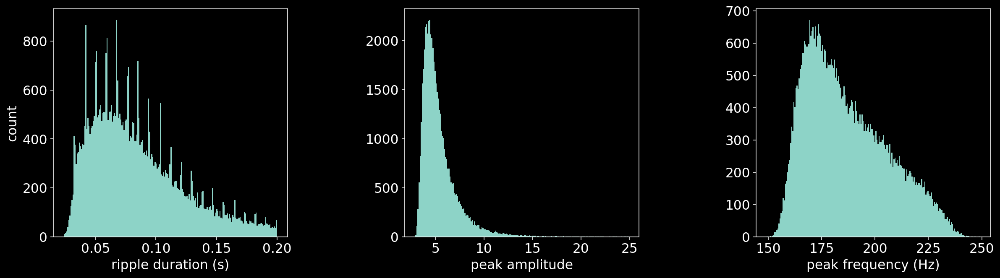

In [21]:
fig, axs = plt.subplots(1,3, figsize=(20, 5), edgecolor='k')
fig.subplots_adjust(hspace = 0.5, wspace=0.5)
axs = axs.ravel()

axs[0].hist(df.ripple_duration,200)
axs[0].set_ylabel('count')
axs[0].set_xlabel('ripple duration (s)')

axs[1].hist(df.peak_amplitude,200)
axs[1].set_xlabel('peak amplitude')

axs[2].hist(df.peak_freq,200)
axs[2].set_xlabel('peak frequency (Hz)')

plt.show()

## plot all ripples for each session

Note: ripple maps were generated from the channel with the peak amplitude (see detect_swr_with_ripple_detection). The below ripple traces might not reflect exactly the ripple event that was detected in a minority of cases. 

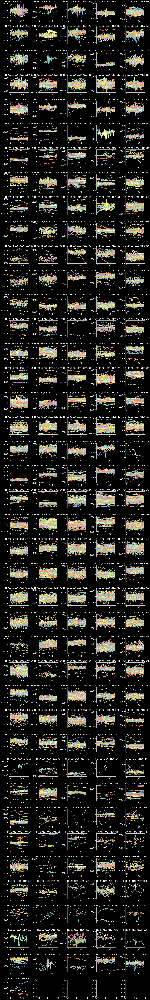

In [22]:
session_list = pd.unique(df.session)
n_columns = 5
n_rows = math.ceil(len(session_list)/n_columns) 

fig, axs = plt.subplots(n_rows,n_columns, figsize=(20, 150), edgecolor='k')
fig.subplots_adjust(hspace = 0.5, wspace=0.5)
axs = axs.ravel()

for i,s in enumerate(session_list):
    idx = df.session == s
    axs[i].plot(ripple_maps[idx].T)
    axs[i].set_title(s)

## Mean ripples over sessions

In [ ]:
session_list = pd.unique(df.session)
n_columns = 5
n_rows = math.ceil(len(session_list)/n_columns) 

fig, axs = plt.subplots(n_rows,n_columns, figsize=(20, 150), edgecolor='k')
fig.subplots_adjust(hspace = 0.5, wspace=0.5)
axs = axs.ravel()

for i,s in enumerate(session_list):
    idx = df.session == s
    axs[i].plot(np.mean(ripple_maps[idx],axis=0))
    axs[i].set_title(s)

In [ ]:
# session_list = pd.unique(df.session)
n_columns = 5
n_rows = math.ceil(len(session_list)/n_columns) 

fig, axs = plt.subplots(n_rows,n_columns, figsize=(20, 150), edgecolor='k')
fig.subplots_adjust(hspace = 0.5, wspace=0.5)
axs = axs.ravel()

for i,s in enumerate(session_list):
    idx = df.session == s
    axs[i].plot(filtered_map[idx].T)
    axs[i].set_title(s)